# IMAGE TO TABLE

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip --version
!pip install --quiet pytesseract==0.3.10
!pip install --quiet opencv-python
!pip install --quiet img2table
!pip install --quiet Pillow
# !pip install --quiet torch torchvision==0.13
# !pip install --quiet craft-text-detector==0.4
# !pip install --quiet matplotlib
# !pip install --quiet numpy
# !pip install --quiet scipy
# !pip install --quiet craft
# !pip install --quiet autotime
# !pip install --quiet PILasOPENCV

pip 23.1.2 from /usr/local/lib/python3.10/dist-packages/pip (python 3.10)


In [3]:
# !sudo apt-get update
!sudo apt-get install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 16 not upgraded.


In [4]:
# !wget https://github.com/tesseract-ocr/tessdata/raw/master/vie.traineddata
!wget https://github.com/tesseract-ocr/tessdata/raw/main/vie.traineddata
!sudo mv vie.traineddata /usr/share/tesseract-ocr/4.00/tessdata/
!ls
!export TESSDATA_PREFIX=/usr/share/tesseract-ocr/4.00/

--2023-08-11 15:38:17--  https://github.com/tesseract-ocr/tessdata/raw/main/vie.traineddata
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/tesseract-ocr/tessdata/main/vie.traineddata [following]
--2023-08-11 15:38:18--  https://raw.githubusercontent.com/tesseract-ocr/tessdata/main/vie.traineddata
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7763728 (7.4M) [application/octet-stream]
Saving to: ‘vie.traineddata’

vie.traineddata     100%[===================>]   7.40M  --.-KB/s    in 0.09s   

2023-08-11 15:38:18 (85.5 MB/s) - ‘vie.traineddata’ saved [7763728/7763728]

dest.png   drive      out

## Begin

In [5]:

# %load_ext autotime

In [6]:
from IPython.display import display_html
from PIL import Image as PILImage
from openpyxl import load_workbook
from io import BytesIO
import cv2
from img2table.document import Image
from img2table.ocr import TesseractOCR
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from google.colab.patches import cv2_imshow
import enum
from img2table.document import Image

In [7]:
!ls drive/MyDrive/DIP/data-scoresheets/
!rm drive/MyDrive/DIP/data-scoresheets/*-result.jpg
!rm drive/MyDrive/DIP/data-scoresheets/*.xlsx
!ls drive/MyDrive/DIP/data-scoresheets/
!mkdir drive/MyDrive/DIP/data-scoresheets/output
!mkdir drive/MyDrive/DIP/data-scoresheets/excel
!rm drive/MyDrive/DIP/data-scoresheets/excel/*.xlsx
!rm drive/MyDrive/DIP/data-scoresheets/output/*-result.jpg

test10.jpg  test14.jpg	test18.jpg  test21.jpg	test2.jpg  test6.jpg
test11.jpg  test15.jpg	test19.jpg  test22.jpg	test3.jpg  test7.jpg
test12.jpg  test16.jpg	test1.jpg   test23.jpg	test4.jpg  test8.jpg
test13.jpg  test17.jpg	test20.jpg  test24.jpg	test5.jpg  test9.jpg
rm: cannot remove 'drive/MyDrive/DIP/data-scoresheets/*-result.jpg': No such file or directory
rm: cannot remove 'drive/MyDrive/DIP/data-scoresheets/*.xlsx': No such file or directory
test10.jpg  test14.jpg	test18.jpg  test21.jpg	test2.jpg  test6.jpg
test11.jpg  test15.jpg	test19.jpg  test22.jpg	test3.jpg  test7.jpg
test12.jpg  test16.jpg	test1.jpg   test23.jpg	test4.jpg  test8.jpg
test13.jpg  test17.jpg	test20.jpg  test24.jpg	test5.jpg  test9.jpg
rm: cannot remove 'drive/MyDrive/DIP/data-scoresheets/excel/*.xlsx': No such file or directory
rm: cannot remove 'drive/MyDrive/DIP/data-scoresheets/output/*-result.jpg': No such file or directory


In [8]:
len_data_test = 30
prefix = "drive/MyDrive/DIP/data-scoresheets/"
paths = [(f"{prefix}test{i}.jpg", \
          f"{prefix}/excel/test{i}.xlsx", \
          f"{prefix}/output/test{i}-result.jpg") for i in range(0, len_data_test)]
print(len(paths))

29


In [9]:
def processing(image, cv2_images, path_excel):
  image_tables = image.extract_tables()
  table = image_tables[0]
  bbox = table.bbox
  cv2.rectangle(cv2_images, (bbox.x1, bbox.y1), (bbox.x2, bbox.y2), (0, 255, 255), 5)
  # cv2_images = cv2_images[bbox.y1:bbox.y2, bbox.x1: bbox.x2]
  cv2_imshow(cv2_images)

  # tesseract_ocr = TesseractOCR(n_threads=1, lang="eng")
  tesseract_ocr = TesseractOCR(n_threads=1, lang="vie")
  extracted_tables = image.extract_tables(ocr=tesseract_ocr,\
                                      implicit_rows=False,\
                                      borderless_tables=False,\
                                      min_confidence=50)

  for table in extracted_tables:
      for row in table.content.values():
          for cell in row:
            # print(cell.value)
            cv2.rectangle(cv2_images, \
                          (cell.bbox.x1, cell.bbox.y1), \
                          (cell.bbox.x2, cell.bbox.y2), \
                          (255, 0, 0), 2)
            cv2.putText(cv2_images, cell.value, (cell.bbox.x1, cell.bbox.y1), \
                        cv2.FONT_HERSHEY_SIMPLEX,
                        1, (255, 255, 0),
                        2)

  PILImage.fromarray(cv2_images)

  img.to_xlsx(dest=path_excel,
            ocr=tesseract_ocr,
            implicit_rows=False,
            borderless_tables=False,
            min_confidence=50)

  return cv2_images

drive/MyDrive/DIP/data-scoresheets/test1.jpg


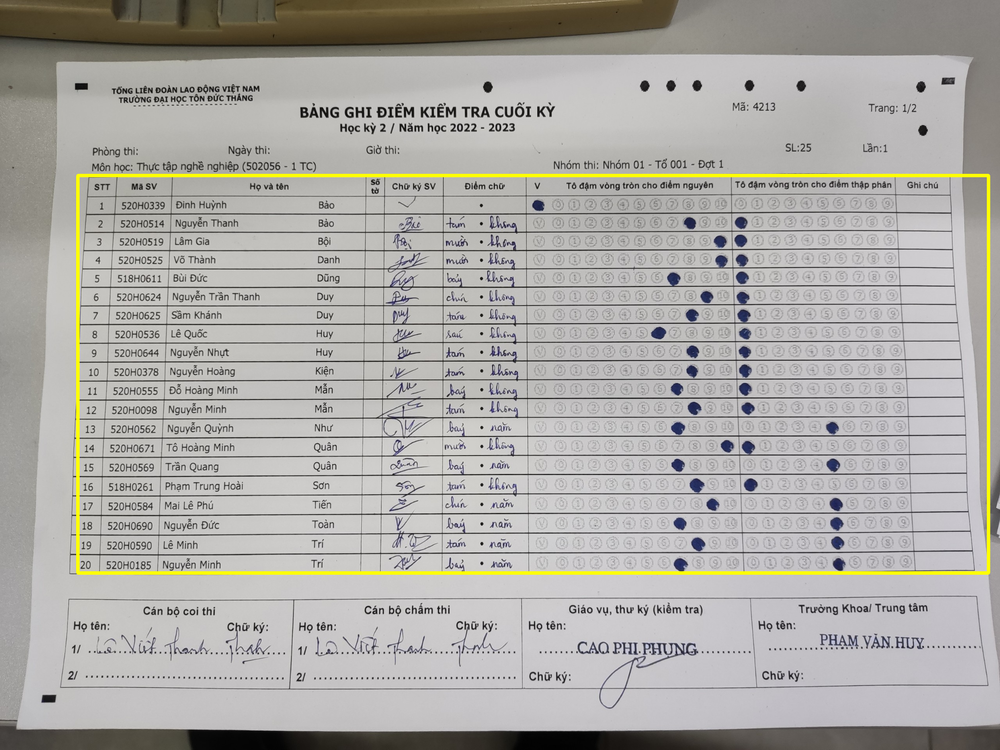

drive/MyDrive/DIP/data-scoresheets/test2.jpg


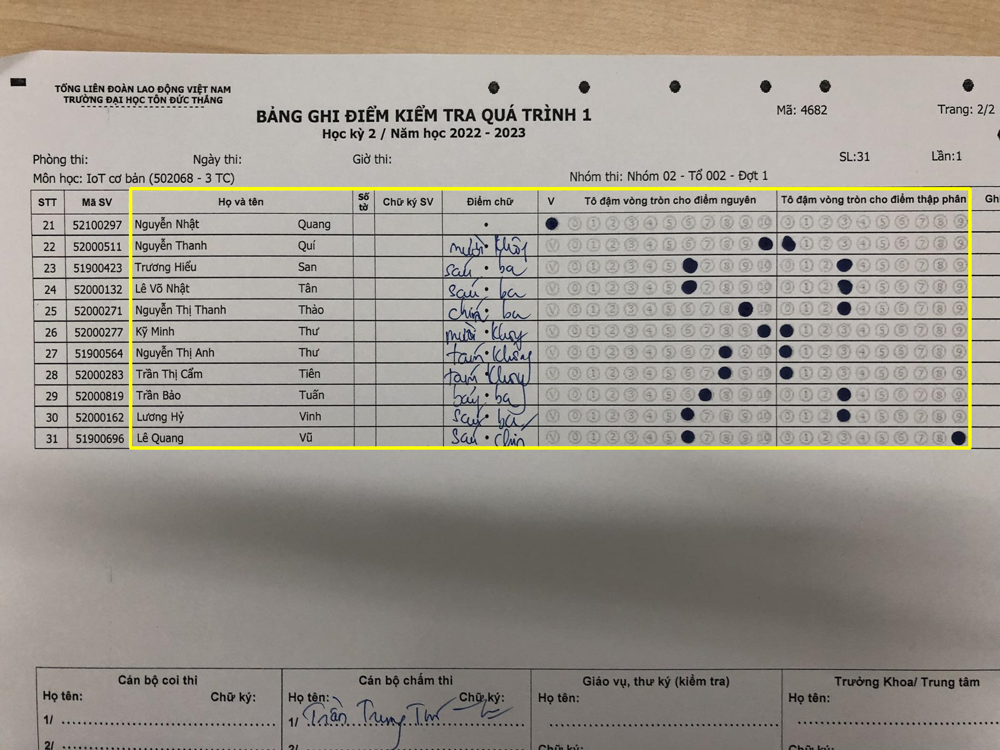

drive/MyDrive/DIP/data-scoresheets/test3.jpg


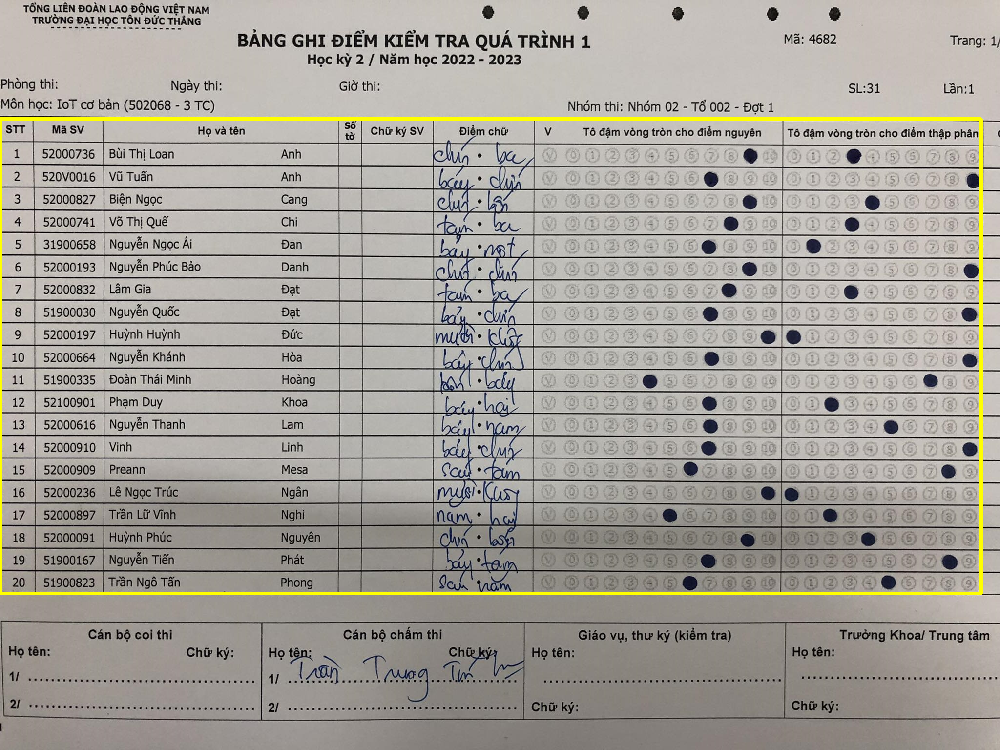

drive/MyDrive/DIP/data-scoresheets/test4.jpg


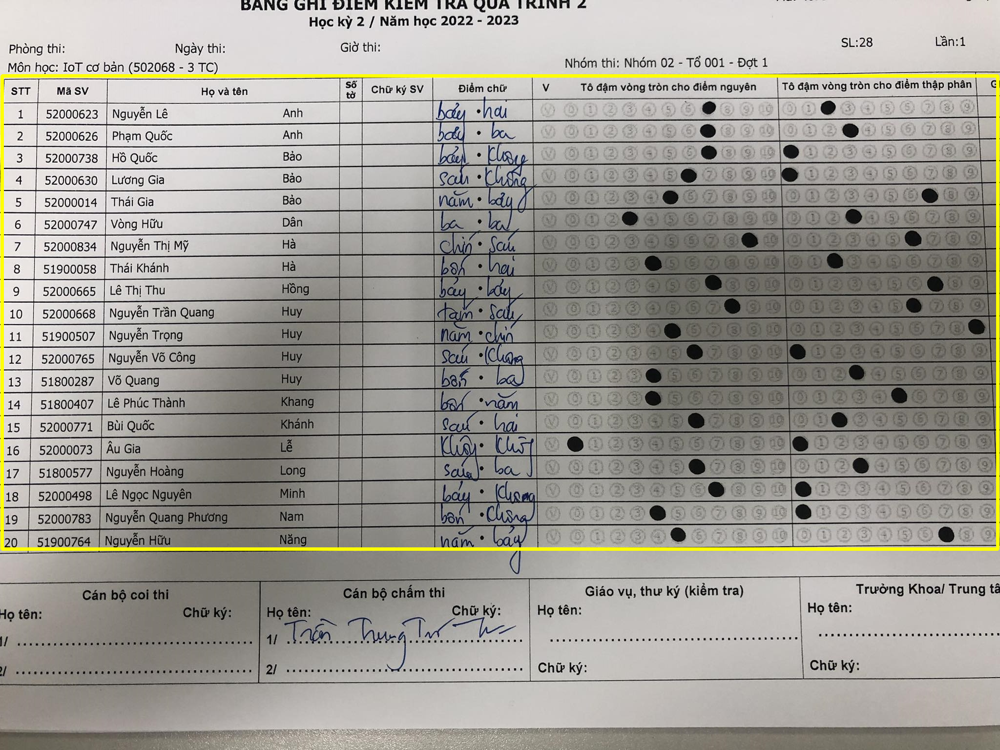

drive/MyDrive/DIP/data-scoresheets/test5.jpg


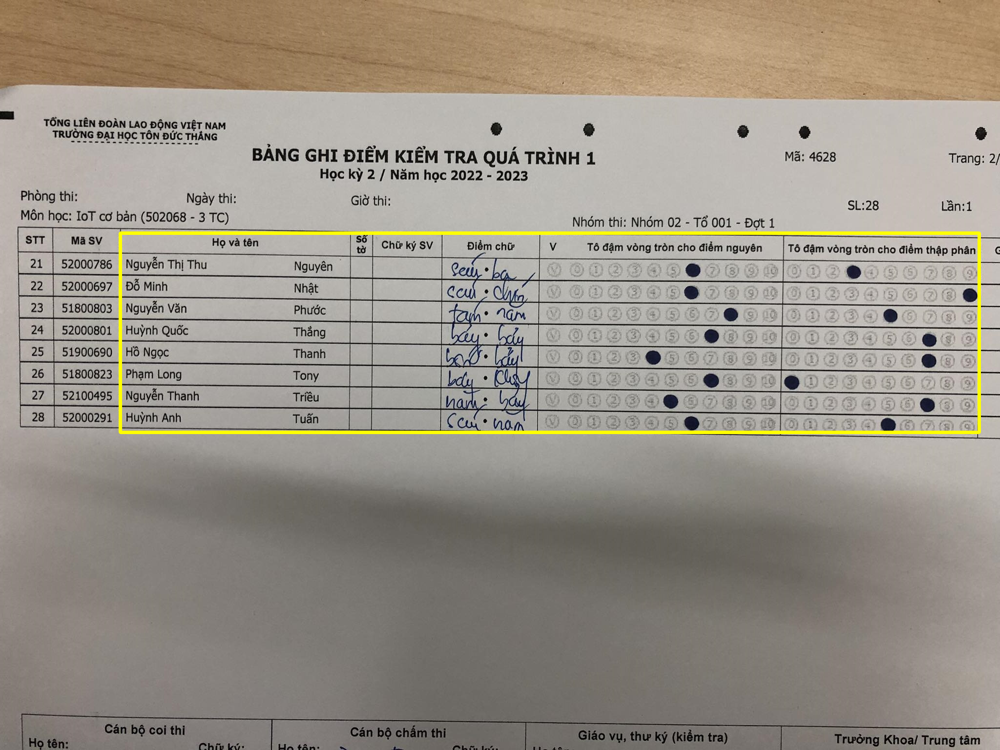

drive/MyDrive/DIP/data-scoresheets/test6.jpg


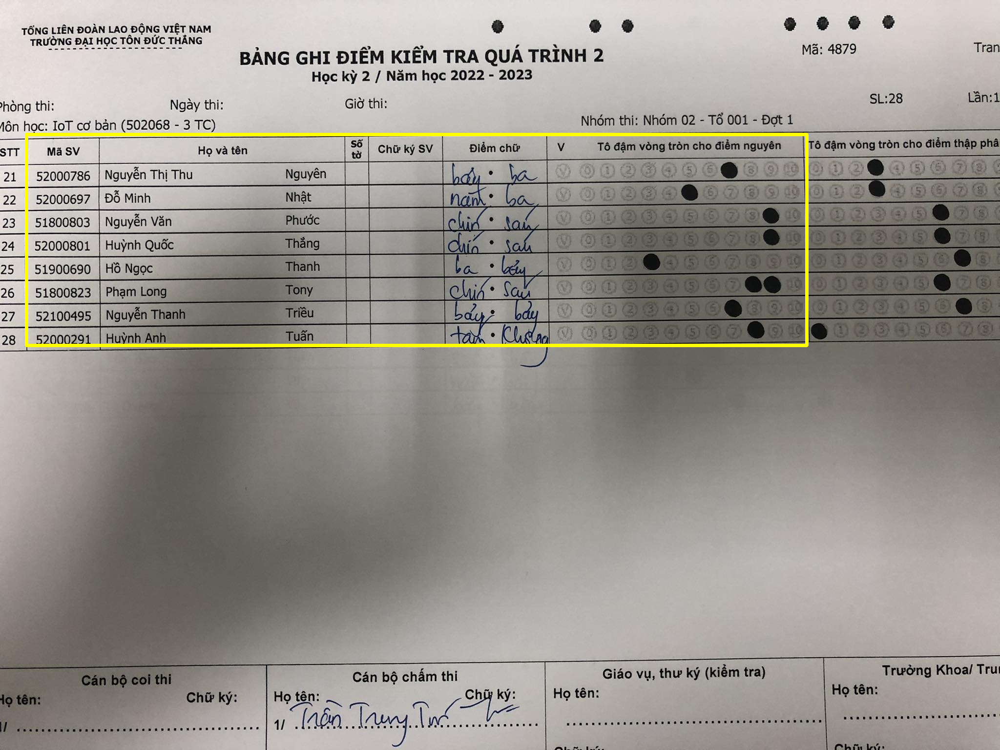

drive/MyDrive/DIP/data-scoresheets/test7.jpg


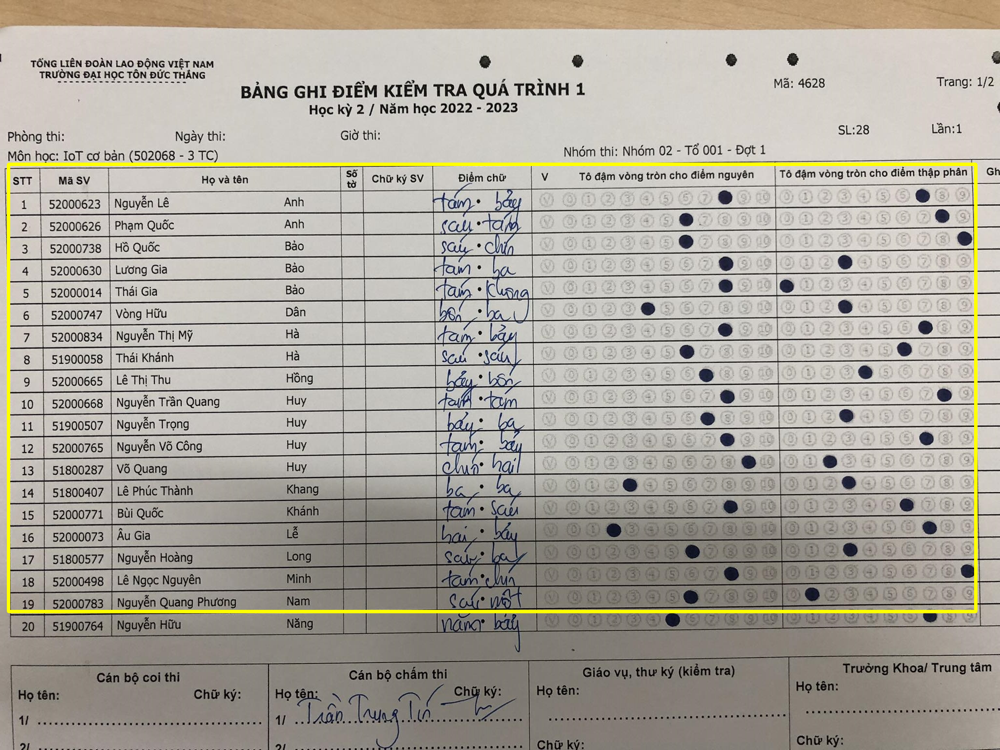

drive/MyDrive/DIP/data-scoresheets/test8.jpg
	Error --> int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
drive/MyDrive/DIP/data-scoresheets/test9.jpg


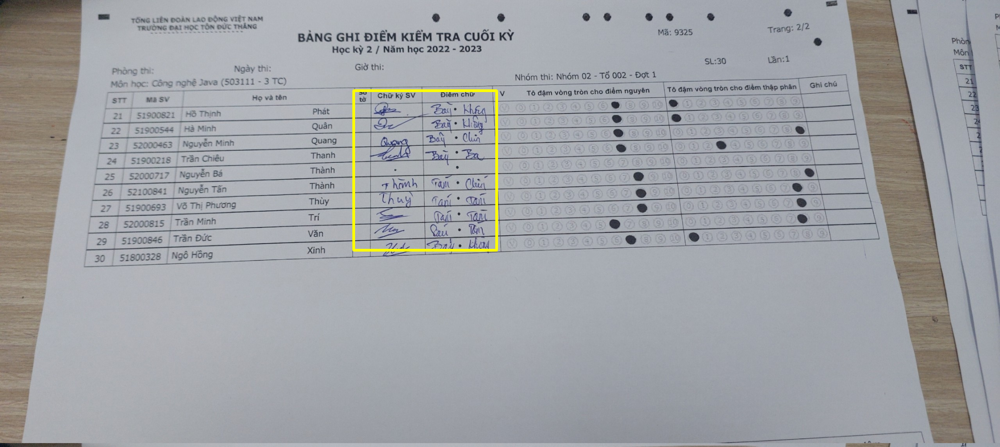

drive/MyDrive/DIP/data-scoresheets/test10.jpg
	Error --> int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
drive/MyDrive/DIP/data-scoresheets/test11.jpg


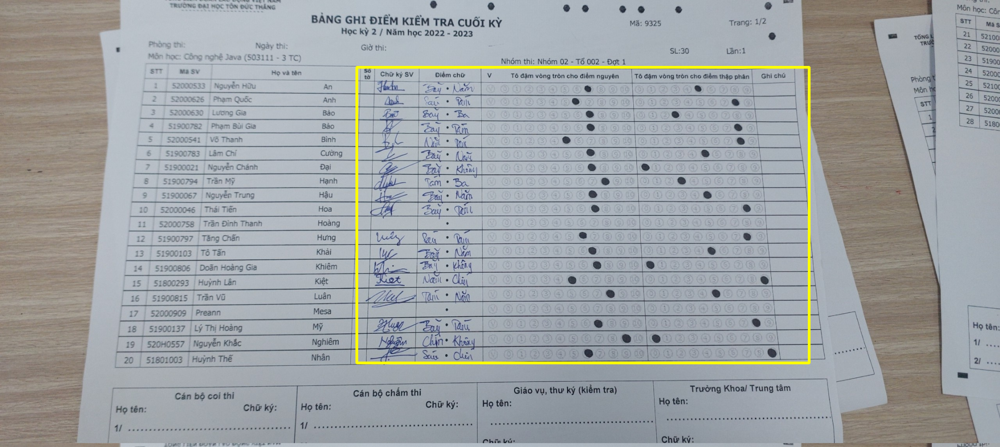

drive/MyDrive/DIP/data-scoresheets/test12.jpg
	Error --> int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
drive/MyDrive/DIP/data-scoresheets/test13.jpg
	Error --> int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
drive/MyDrive/DIP/data-scoresheets/test14.jpg
	Error --> int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
drive/MyDrive/DIP/data-scoresheets/test15.jpg
	Error --> int() argument must be a string, a bytes-like object or a real number, not 'NoneType'
drive/MyDrive/DIP/data-scoresheets/test16.jpg


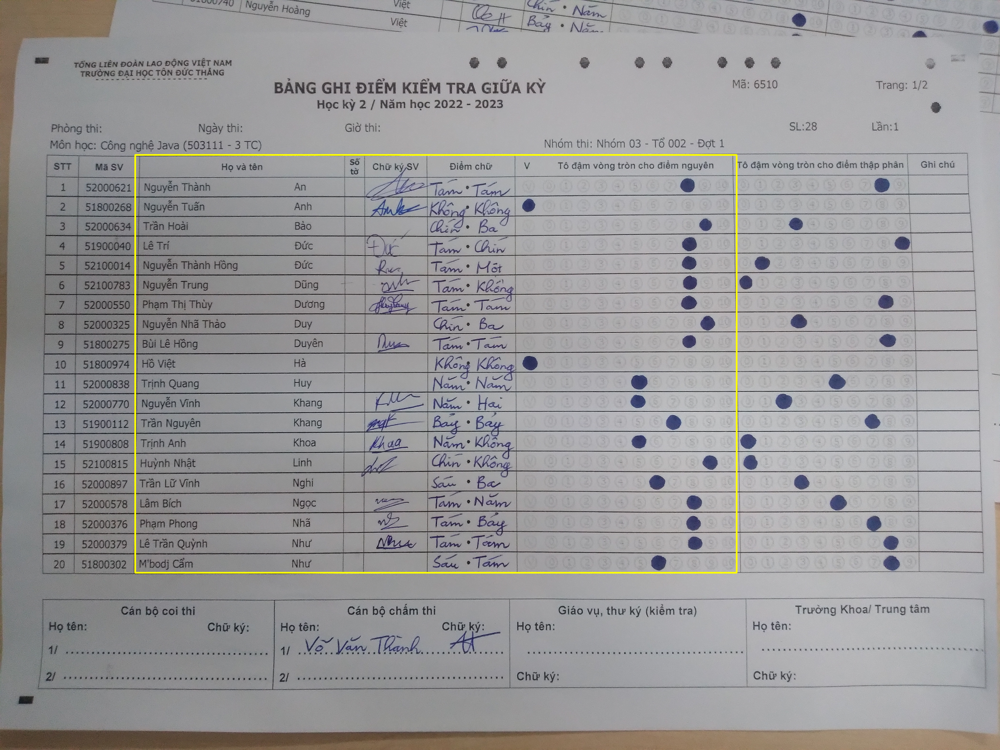

/usr/local/lib/python3.10/dist-packages/xlsxwriter/worksheet.py:2209: UserWarning: Can't merge single cell
  warn("Can't merge single cell")


drive/MyDrive/DIP/data-scoresheets/test17.jpg
Buffered data was truncated after reaching the output size limit.

In [ ]:
for path_img, path_excel, path_output in paths:
  try:
    print(path_img)
    img = Image(src=path_img)
    image = cv2.imread(path_img)
    output = processing(img, image, path_excel)
    cv2.imwrite(path_output, output)
  except Exception as e:
    print(f"\tError --> {e}")
    continue

In [ ]:
def loop(path_image):
    path = "drive/MyDrive/DIP/data-scoresheets/" + path_image
    print(path)

    # Đọc ảnh
    image = cv2.imread(path, 0)

    # Áp dụng Gaussian Blur để giảm nhiễu
    blurred = cv2.GaussianBlur(image, (5, 5), 0)

    # Dùng Hough Circle Transform để phát hiện các vòng tròn
    circles = cv2.HoughCircles(
        blurred,
        cv2.HOUGH_GRADIENT,
        1,
        20,
        param1=50,
        param2=30,
        minRadius=1,
        maxRadius=20,
    )

    x_start = image.shape[1]
    y_start = image.shape[0]
    x_end = 0
    y_end = 0

    print(x_start, y_start, x_end, y_end)

    # Nếu tìm thấy các vòng tròn
    if circles is not None:
        circles = np.round(circles[0, :]).astype("int")

        # Vẽ các vòng tròn đã tìm thấy lên ảnh gốc
        for x, y, r in circles:
            cv2.circle(image, (x, y), r, (0, 255, 0), 2)

            if x > x_end:
                x_end = x
            if x < x_start:
                x_start = x

            if y > y_end:
                y_end = y
            if y < y_start:
                y_start = y
        print(x_start, y_start, x_end, y_end)

        cv2.rectangle(image, (x_start, y_start),
                      (x_end, y_end), (0, 255, 0), 2)
        cv2.imwrite("drive/MyDrive/DIP/data-scoresheets/output/" + path_image , image)
        print("drive/MyDrive/DIP/data-scoresheets/output/" + path_image)

    else:
        print("Không tìm thấy vòng tròn trong ảnh")

## END